# Much Simpler Algorithm for Lambertian Photometric Stereo

In [12]:
# Imports
import matplotlib.pyplot as plt
import cv2
import glob
import os
import numpy as np

# Make figure resolution higher
plt.rcParams['figure.dpi'] = 300
plt.rcParams['savefig.dpi'] = 300

In [13]:
# Reading in images
def imread(file_name, intensities=None, normalize=False, flag=-1, scale=1.0):
    img_names = glob.glob(file_name) # Get all of a certain file type that matches file_name
    img_list = []
    if len(img_names) == 0:
        print("[No {} images]".format(file_name))
        exit()
    img_names = sorted(img_names)
    for i, path in enumerate(img_names):
        im = cv2.imread(path, flag)
        width_multiplier = 730 / int(im.shape[1])
        height_multiplier = 730 / int(im.shape[0])
        img = cv2.resize(im, None, fx=scale, fy=scale) # Read in image
        # Normalize if needed (in this case since it's images of the moon it's almost grayscale so it doesn't make much of a difference anyway)
        if np.any(intensities):
            img = img / intensities[i]
        elif normalize:
            img = img / 255.0
        # img = img[:, :, :-1]
        print(img.dtype)
        img_list.append(img)
    return img_list

In [14]:
from numpy import loadtxt

dataPath = "test_data/"
object = []
for obj in (os.listdir(dataPath)):
    object.append(obj)

L_direction = loadtxt(f"./light_directions.txt") # Load in the light directions

imgs = imread(f"./test_data/*.jpg", intensities=None, normalize=False)
imgs

uint8
uint8
uint8
uint8
uint8
uint8
uint8
uint8
uint8
uint8
uint8
uint8
uint8
uint8
uint8
uint8
uint8
uint8
uint8
uint8
uint8
uint8
uint8
uint8


[array([[[0, 0, 0],
         [0, 0, 0],
         [0, 0, 0],
         ...,
         [0, 0, 0],
         [0, 0, 0],
         [0, 0, 0]],
 
        [[0, 0, 0],
         [0, 0, 0],
         [0, 0, 0],
         ...,
         [0, 0, 0],
         [0, 0, 0],
         [0, 0, 0]],
 
        [[0, 0, 0],
         [0, 0, 0],
         [0, 0, 0],
         ...,
         [0, 0, 0],
         [0, 0, 0],
         [0, 0, 0]],
 
        ...,
 
        [[0, 0, 0],
         [0, 0, 0],
         [0, 0, 0],
         ...,
         [0, 0, 0],
         [0, 0, 0],
         [0, 0, 0]],
 
        [[0, 0, 0],
         [0, 0, 0],
         [0, 0, 0],
         ...,
         [0, 0, 0],
         [0, 0, 0],
         [0, 0, 0]],
 
        [[0, 0, 0],
         [0, 0, 0],
         [0, 0, 0],
         ...,
         [0, 0, 0],
         [0, 0, 0],
         [0, 0, 0]]], dtype=uint8),
 array([[[0, 0, 0],
         [0, 0, 0],
         [0, 0, 0],
         ...,
         [0, 0, 0],
         [0, 0, 0],
         [0, 0, 0]],
 
        [[0, 

In [15]:
# Shouldn't really change anything
for i, img in enumerate(imgs):
    imgs[i] = cv2.bitwise_and(img, img, mask=None)
    i += 1

print(imgs)
imgs = np.array(imgs)

[array([[[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       ...,

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]]], dtype=uint8), array([[[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,

In [16]:
# Actual photometric stereo algorithm (kinda complicated but I think I get it)
# Uses pseudoinverse to solve for the surface normals and albedos
def photometric_stereo(imgs, L_list):
    """
    Perform photometric stereo using multiple images of an object captured under different light sources.

    Parameters
    ----------
    imgs: np.ndarray
        Numpy array containing all the images of the object taken with different light sources.
    L_list: list
        List of light source directions (vectors with 3 positional elements x, y, z) for each image.

    Returns
    -------
    img_normal: np.ndarray
        Computed surface normals of the object.
    img_albedo: np.ndarray
        Computed albedos (reflectance) of the object.
    img_normal_rgb: np.ndarray
        RGB representation of the surface normals for visualization.
    """

    # Convert L_list to a numpy array for easier manipulation
    L = np.array(L_list)
    # Transpose the array
    Lt = L.T

    # Get the height and width of the first image in the set
    h, w = imgs[0].shape[:2]

    # Initialize arrays for storing computed values
    img_normal = np.zeros((h, w, 3))
    img_albedo = np.zeros((h, w, 3))
    I = np.zeros((len(L_list), 3))

    # Iterate over each pixel in the images
    for x in range(w):
        for y in range(h):
            # Collect intensity values for each image at the current pixel
            for i in range(len(imgs)):
                I[i] = imgs[i][y][x]

            # Compute surface normals and albedos using photometric stereo equations
            tmp1 = np.linalg.pinv(np.dot(Lt, L)) # Psuedoinverse
            tmp2 = np.dot(Lt, I)
            N = np.dot(tmp1, tmp2).T
            rho = np.linalg.norm(N, axis=1)
            img_albedo[y][x] = rho

            # Convert surface normals to grayscale and normalize
            N_gray = N[0] * 0.0722 + N[1] * 0.7152 + N[2] * 0.2126
            Nnorm = np.linalg.norm(N)
            if Nnorm == 0:
                continue
            img_normal[y][x] = N_gray / Nnorm

    # Convert the computed values for visualization
    img_normal_rgb = ((img_normal * 0.5 + 0.5) * 255).astype(np.uint8)
    img_normal_rgb = cv2.cvtColor(img_normal_rgb, cv2.COLOR_BGR2RGB) # Recolor from the BGR cv2 uses to RGB
    img_albedo = (img_albedo / np.max(img_albedo) * 255).astype(np.uint8)

    return img_normal, img_albedo, img_normal_rgb

In [17]:
img_normal, img_albedo, img_normal_rgb = photometric_stereo(imgs, L_direction)
cv2.imwrite(f"./output/normal_rgb.png", img_normal_rgb)
cv2.imwrite(f"./output/albedo.png", img_albedo)

True

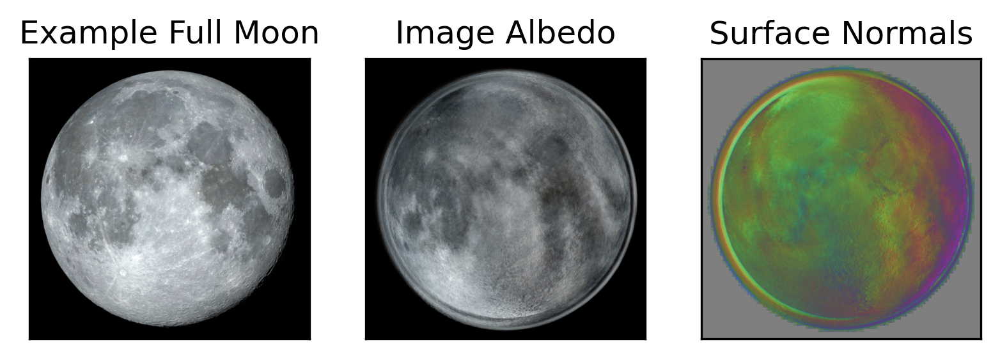

In [18]:
plt.figure()
plt.subplot(1,3,1)
example_img_index = 4
img = (imgs[example_img_index] - np.min(imgs[example_img_index])) / (np.max(imgs[example_img_index]) - np.min(imgs[example_img_index]))  #normalizing image between 0-1 for visualization
plt.imshow(img)
plt.title('Example Full Moon')
plt.xticks([])
plt.yticks([])
#plt.plot([1,2,3,4])
plt.subplot(1,3,2)
#plt.plot([1,2,3,4])
plt.imshow(img_albedo)
plt.title('Image Albedo')
plt.xticks([])
plt.yticks([])
plt.subplot(1,3,3)
#plt.plot([1,2,3,4])
plt.imshow(img_normal_rgb)
plt.title('Surface Normals')
plt.xticks([])
plt.yticks([])
plt.show()

# Everything works up until here ⤴️

In [19]:
# Height map test - not working yet
from heightmap import estimate_height_map
from skimage import io
import plotly.graph_objects as go
NORMAL_MAP_A_PATH: str = "./output/normal_rgb.png"
NORMAL_MAP_A_IMAGE: np.ndarray = io.imread(NORMAL_MAP_A_PATH)
heights = estimate_height_map(NORMAL_MAP_A_IMAGE, raw_values=True)

# figure, axes = plt.subplots(1, 2, figsize=(7, 3))
# _ = axes[0].imshow(NORMAL_MAP_A_IMAGE)
# _ = axes[1].imshow(heights)
print(heights)

x, y = np.meshgrid(range(heights.shape[1]), range(heights.shape[0]))
# _, axes = plt.subplots(1, 1, subplot_kw={"projection": "3d"})
# _ = axes.scatter(x, y, heights, c=heights)
fig = go.Figure(data=[go.Surface(x=x, y=y, z=heights)])
fig.update_layout(title='Moon Height Map', autosize=False,
                  width=500, height=500,
                  margin=dict(l=65, r=50, b=65, t=90))
fig.show()

[[-4.41536118 -5.60563526 -5.51477354 ... 11.53854737 11.58395604
   9.54597567]
 [-5.5925503  -6.2834129  -6.28349965 ... 13.18796313 13.18310676
  11.77845188]
 [-5.57227143 -6.30844389 -6.30807794 ... 13.22470674 13.21999385
  11.56647205]
 ...
 [-8.05770524 -9.11496845 -9.11830079 ...  3.14813564  3.16193938
   2.87541161]
 [-7.94851952 -9.09794451 -9.10036534 ...  3.12839906  3.14084067
   2.74948106]
 [-6.54737668 -8.14653882 -7.94340958 ...  2.77131227  2.68890031
   2.41972332]]


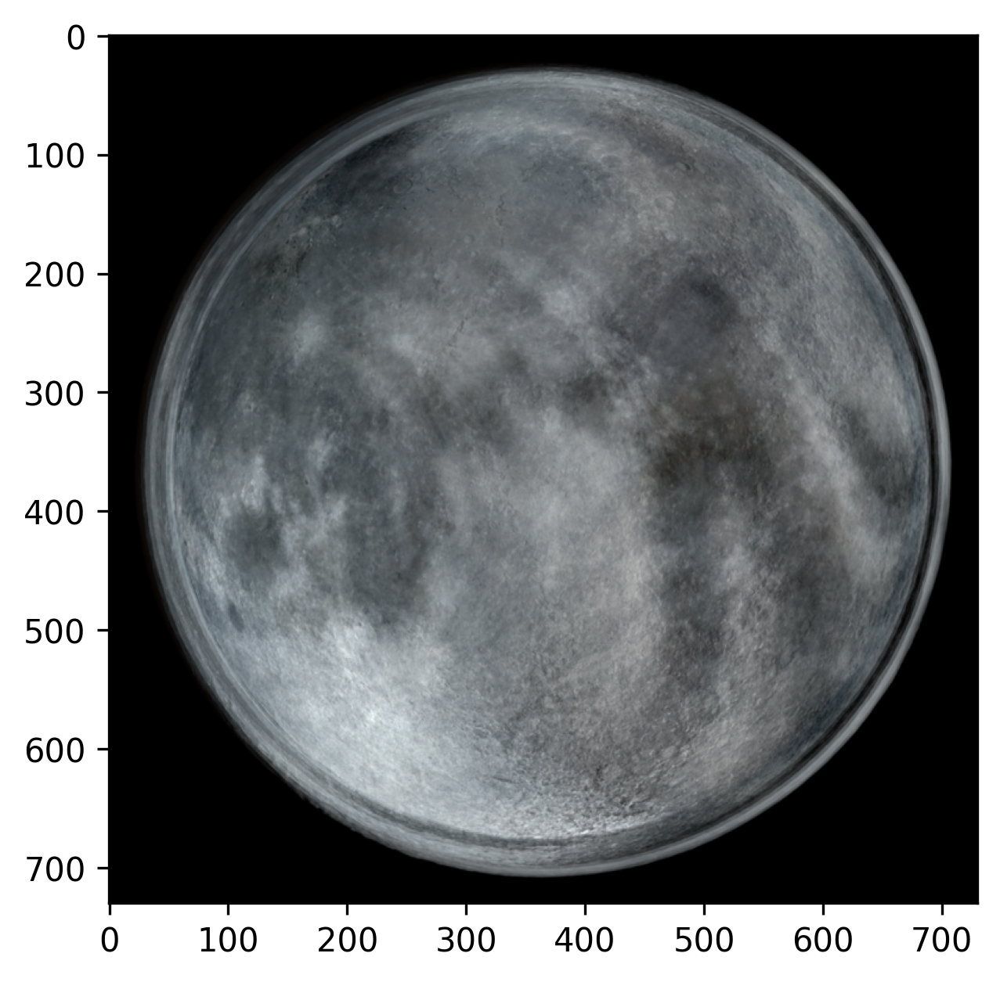

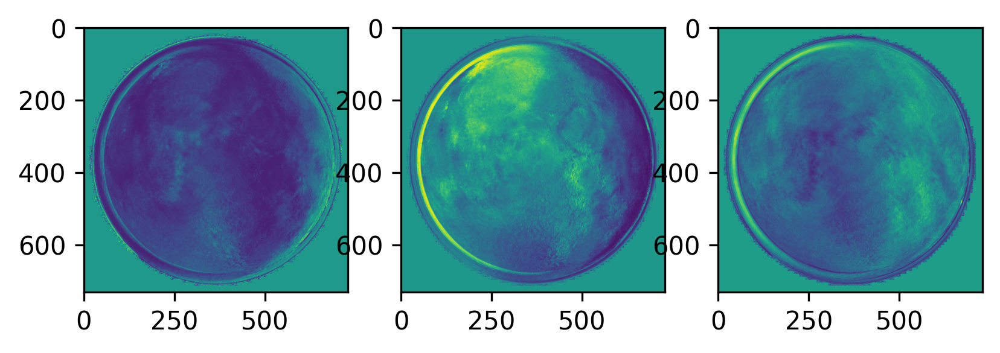

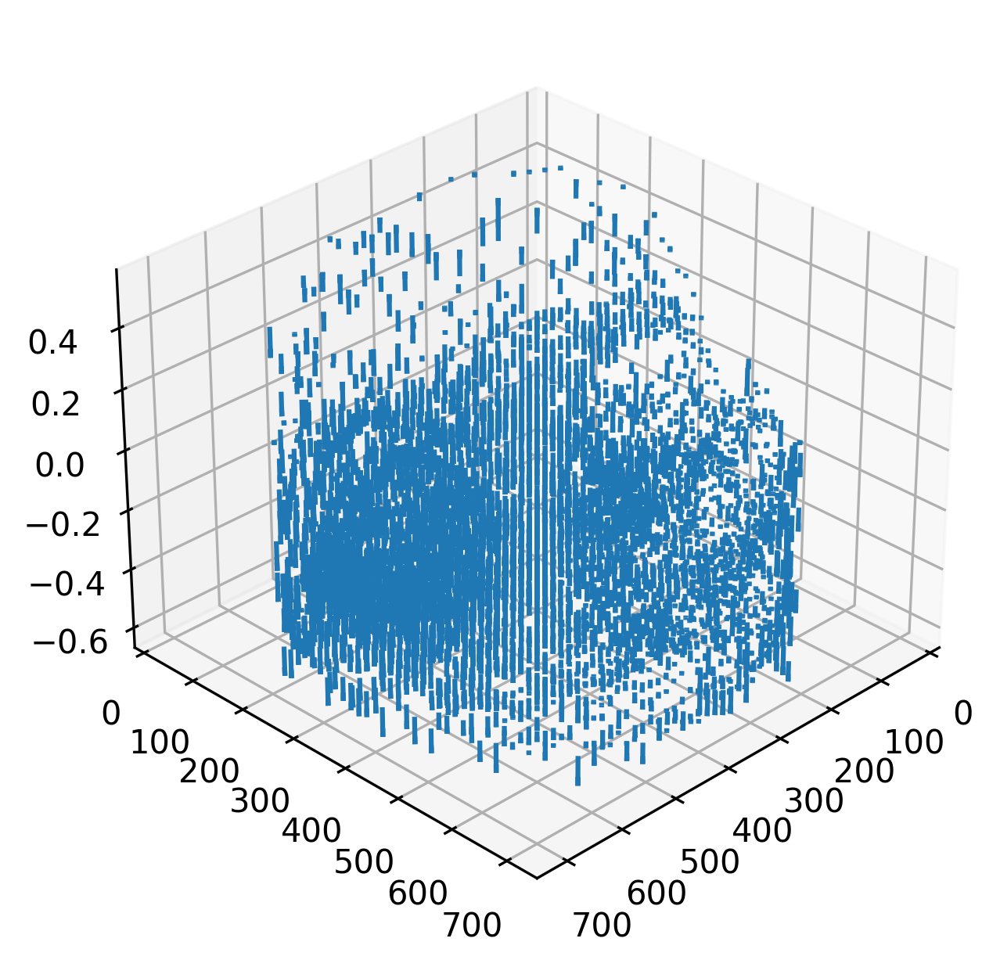

ValueError: Argument Z must be 2-dimensional.

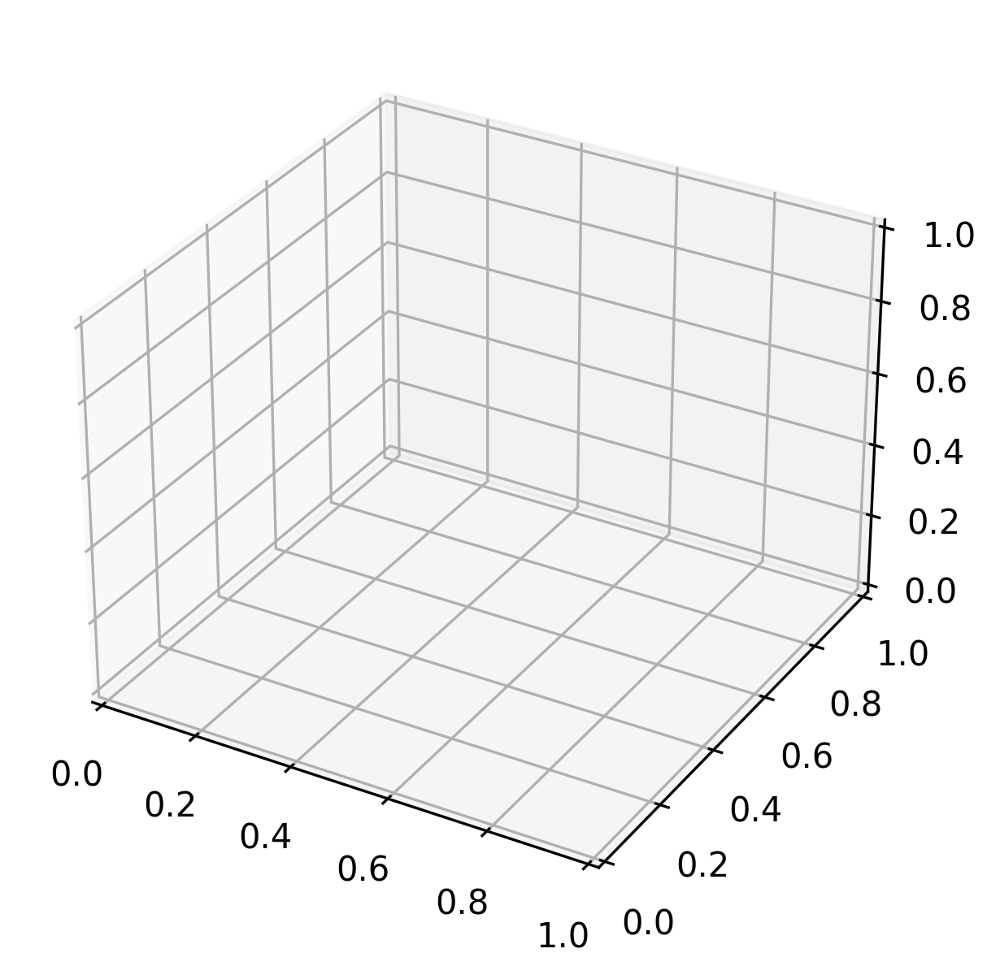

In [20]:
# Experimental visualization vector map?? (not working either)
def visualize(albedo, normals, horn_depth):
    # Stride in the plot, you may want to adjust it to different images
    stride = 15
    # showing albedo map
    fig = plt.figure()
    # albedo_max = albedo.max()
    # albedo = albedo / albedo_max
    plt.imshow(albedo, cmap="gray")
    plt.show()
    # showing normals as three separate channels
    figure = plt.figure()
    ax1 = figure.add_subplot(131)
    ax1.imshow(normals[..., 0])
    ax2 = figure.add_subplot(132)
    ax2.imshow(normals[..., 1])
    ax3 = figure.add_subplot(133)
    ax3.imshow(normals[..., 2])
    plt.show()
    # showing normals as quiver
    X, Y, _ = np.meshgrid(np.arange(0,np.shape(normals)[0], 15),
    np.arange(0,np.shape(normals)[1], 15),
    np.arange(1))
    X = X[..., 0]
    Y = Y[..., 0]
    Z = horn_depth[::stride,::stride].T
    NX = normals[..., 0][::stride,::-stride].T
    NY = normals[..., 1][::-stride,::stride].T
    NZ = normals[..., 2][::stride,::stride].T
    fig = plt.figure(figsize=(5, 5))
    ax = fig.add_subplot(projection='3d')
    ax.view_init(elev=30, azim=45, roll=0)
    plt.quiver(X,Y,Z,NX,NY,NZ, length=0.1, normalize=True)
    # fig2 = go.Figure(data=go.Cone(x=X, y=Y, z=Z, u=NX, v=NY, w=NZ, sizemode="absolute", sizeref=2, anchor="tip"))
    # fig2.update_layout(title='Moon Surface Normals', autosize=False, scene=dict(domain_x=[0, 1], domain_y=[0, 1]))
    # fig2.show()
    plt.show()
    # plotting wireframe depth map
    H = horn_depth[::stride,::stride]
    fig = plt.figure()
    ax = fig.add_subplot(projection='3d')
    ax.plot_surface(X,Y, H.T)
    plt.show()

visualize(img_albedo, img_normal, img_normal)